Comparing a simulation after replacing c3 with c2 emissions, with a default run. Both are using geos chem classic v 13.4. 

In the command line: 

```
aws configure 

aws s3 cp s3://geosfp-fullchem-nospinup-2015-06-newemiss-08122022/OutputDir/GEOSChem.SpeciesConc.20150601_0000z.nc4 ~/

aws s3 cp s3://geosfp-fullchem-nospinup-07-21-22/rundirs/gc_4x5_geosfp_fullchem/OutputDir/GEOSChem.SpeciesConc.20190701_0000z.nc4 ~/
```

In [17]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import pandas as pd
import pytz
from matplotlib.cm import get_cmap
import cartopy.crs as ccrs, bokeh
import bokeh
print(bokeh.__version__)
import bokeh.io
import bokeh.plotting
from bokeh.plotting import figure
bokeh.io.output_notebook()

0.13.0


Loading BokehJS ...

In [2]:
ds_defaultemiss = xr.open_dataset("~/GEOSChem.SpeciesConc.20190701_0000z.nc4")
ds_updatedemiss = xr.open_dataset("~/GEOSChem.SpeciesConc.20150601_0000z.nc4")

In [3]:
ds_defaultemiss_small = ds_defaultemiss[['SpeciesConc_C2H6','SpeciesConc_C3H8']]
ds_updatedemiss_small = ds_updatedemiss[['SpeciesConc_C2H6','SpeciesConc_C3H8']]

In [6]:
defaultemiss_df = ds_defaultemiss_small.to_dataframe().reset_index()
updatedemiss_df = ds_updatedemiss_small.to_dataframe().reset_index()

In [13]:
fh = 400
fw = 400
colors = bokeh.palettes.d3['Category20'][20]


p = bokeh.plotting.figure(height=fh, width=fw, title='')
p.circle(defaultemiss_df.lat.values,
         defaultemiss_df.SpeciesConc_C2H6.values*1e9, size=5, 
         color=colors[2],legend='default (from 2019)')

p.circle(updatedemiss_df.lat.values,
         updatedemiss_df.SpeciesConc_C2H6.values*1e9, size=5, 
         color=colors[1],legend='updated (from 2015)')
p.xaxis.axis_label = "lat"
p.yaxis.axis_label = "c2h6 ppb"
p.legend.location = "top_right"
bokeh.io.show(p)

In [14]:
fh = 400
fw = 400
colors = bokeh.palettes.d3['Category20'][20]


p = bokeh.plotting.figure(height=fh, width=fw, title='')

p.circle(updatedemiss_df.lat.values,
         updatedemiss_df.SpeciesConc_C3H8.values*1e9, size=5, 
         color=colors[1],legend='updated (from 2015)')

p.circle(defaultemiss_df.lat.values,
         defaultemiss_df.SpeciesConc_C3H8.values*1e9, size=5, 
         color=colors[2],legend='default (from 2019)')

p.xaxis.axis_label = "lat"
p.yaxis.axis_label = "c3h8 ppb"
p.legend.location = "top_right"
bokeh.io.show(p)

In [15]:
fh = 400
fw = 400
colors = bokeh.palettes.d3['Category20'][20]


p = bokeh.plotting.figure(height=fh, width=fw, title='')


p.circle(defaultemiss_df.lat.values,
         defaultemiss_df.SpeciesConc_C3H8.values*1e9, size=5, 
         color=colors[2],legend='default (from 2019)')

p.circle(updatedemiss_df.lat.values,
         updatedemiss_df.SpeciesConc_C3H8.values*1e9, size=5, 
         color=colors[1],legend='updated (from 2015)')

p.xaxis.axis_label = "lat"
p.yaxis.axis_label = "c3h8 ppb"
p.legend.location = "top_right"
bokeh.io.show(p)

Try looking at the emissions instead. On the terminal:

```
aws s3 cp s3://geosfp-fullchem-nospinup-2015-06-newemiss-08122022/OutputDir/HEMCO_diagnostics.201506010000.nc ~/

aws s3 cp s3://geosfp-fullchem-nospinup-07-21-22/rundirs/gc_4x5_geosfp_fullchem/OutputDir/HEMCO_diagnostics.201907010000.nc ~/

aws s3 cp s3://hemco-4x5-merra2-2015-2016/OutputDir/HEMCO_sa_diagnostics.201506010000.nc ~/
```

In [20]:
hemco_updated = xr.open_dataset("~/HEMCO_diagnostics.201506010000.nc")
hemco_default = xr.open_dataset("~/HEMCO_diagnostics.201907010000.nc")
hemco_standalone = xr.open_dataset("~/HEMCO_sa_diagnostics.201506010000.nc")

Difference between C2 outputted from simulation - C2 generated from standalone. This should be the same bc it is the same date as well. 

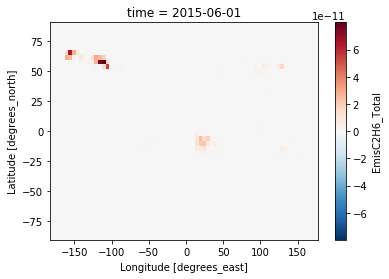

In [24]:
im = (hemco_updated.EmisC2H6_Total.sum(dim='lev') - 
 hemco_standalone.EmisC2H6_Total.sum(dim='lev'))
im.plot()



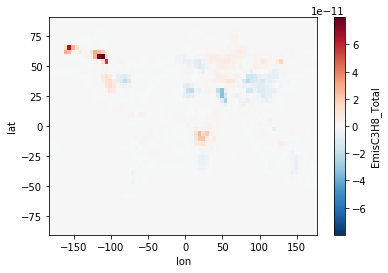

In [25]:
diff_hack = (hemco_updated.isel(time=slice(None, 1)).EmisC3H8_Total.sum(dim='lev').values - hemco_standalone.isel(time=slice(None, 1)).EmisC3H8_Total.sum(dim='lev').values)
ds_hack = xr.Dataset(data_vars=dict(EmisC3H8_Total=(["time","lat","lon"], diff_hack)),coords=dict(lon=(['lon'], hemco_standalone.lon.values), lat=(['lat'], hemco_standalone.lat.values)))
ds_hack.EmisC3H8_Total.plot()

Separate out by type of emissions for C2 to see where the difference lies. 

In [36]:
hdefault_c2ship = hemco_default.EmisC2H6_Ship.to_dataframe().reset_index()
hdefault_c2biob = hemco_default.EmisC2H6_BioBurn.to_dataframe().reset_index()
hdefault_c2anthro = hemco_default.EmisC2H6_Anthro.sum(dim='lev').to_dataframe().reset_index()
hdefault_c2airc = hemco_default.EmisC2H6_Aircraft.sum(dim='lev').to_dataframe().reset_index()

hupdated_c2ship = hemco_updated.EmisC2H6_Ship.to_dataframe().reset_index()
hupdated_c2biob = hemco_updated.EmisC2H6_BioBurn.to_dataframe().reset_index()
hupdated_c2anthro = hemco_updated.EmisC2H6_Anthro.sum(dim='lev').to_dataframe().reset_index()
hupdated_c2airc = hemco_updated.EmisC2H6_Aircraft.sum(dim='lev').to_dataframe().reset_index()


In [39]:
fh = 400
fw = 400
colors = bokeh.palettes.d3['Category20'][20]


p = bokeh.plotting.figure(height=fh, width=fw, title='')


p.circle(hdefault_c2ship.EmisC2H6_Ship.values,
         hupdated_c2ship.EmisC2H6_Ship.values, size=5, 
         color=colors[2])

p.xaxis.axis_label = "default c2 ship 2015"
p.yaxis.axis_label = "updated c2 ship 2015"
p.legend.location = "top_right"
bokeh.io.show(p)

In [40]:
fh = 400
fw = 400
colors = bokeh.palettes.d3['Category20'][20]


p = bokeh.plotting.figure(height=fh, width=fw, title='')


p.circle(hdefault_c2biob.EmisC2H6_BioBurn.values,
         hupdated_c2biob.EmisC2H6_BioBurn.values, size=5, 
         color=colors[2])

p.xaxis.axis_label = "default c2 bioburn 2015"
p.yaxis.axis_label = "updated c2 bioburn 2015"
p.legend.location = "top_right"
bokeh.io.show(p)

In [41]:
fh = 400
fw = 400
colors = bokeh.palettes.d3['Category20'][20]


p = bokeh.plotting.figure(height=fh, width=fw, title='')


p.circle(hdefault_c2anthro.EmisC2H6_Anthro.values,
         hupdated_c2anthro.EmisC2H6_Anthro.values, size=5, 
         color=colors[2])

p.xaxis.axis_label = "default c2 anthro 2015"
p.yaxis.axis_label = "updated c2 anthro 2015"
p.legend.location = "top_right"
bokeh.io.show(p)

In [42]:
fh = 400
fw = 400
colors = bokeh.palettes.d3['Category20'][20]


p = bokeh.plotting.figure(height=fh, width=fw, title='')


p.circle(hdefault_c2airc.EmisC2H6_Aircraft.values,
         hupdated_c2airc.EmisC2H6_Aircraft.values, size=5, 
         color=colors[2])

p.xaxis.axis_label = "default c2 aircraft 2015"
p.yaxis.axis_label = "updated c2 aircraft 2015"
p.legend.location = "top_right"
bokeh.io.show(p)